# General function

In [ ]:
def read_json_result(base_path):
  contenido = os.listdir(base_path)
  jsonData = []
  for item in contenido:
    name = base_path + item
    with open(name, 'r') as f:
      data = json.load(f)
      # tupla = (str(item), data)
      jsonData.append(data)

  return jsonData

In [ ]:
def read_json_result_OCRFormat(base_path):
  contenido = os.listdir(base_path)

  jsonData = []
  for item in contenido:
    name = base_path + item
    with open(name, 'r') as f:
      data = json.load(f)
      if "Biomarker Findings" in data:
        data["Biomakers findings"] = data.pop("Biomarker Findings")
      data["document"] = str(item)
      jsonData.append(data)

  return jsonData

In [ ]:
def getJsonResponse(document_name, processed_list):
  for item in processed_list:
    if item['document'] == document_name:
      return item

  return None

In [ ]:
def levenshtein_similarity(str1, str2):
    return 1 - Levenshtein.distance(str1, str2) / max(len(str1), len(str2))

def cer(reference, hypothesis):
    return Levenshtein.distance(reference, hypothesis) / len(reference)

def wer(reference, hypothesis):
    ref_words = reference.split()
    hyp_words = hypothesis.split()
    return editdistance.eval(ref_words, hyp_words) / len(ref_words)


# Libraries

In [ ]:
!pip install Levenshtein

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 9.1 MB/s eta 0:00:00


In [ ]:
!pip install python-Levenshtein editdistance

In [ ]:
import os
import pandas as pd
import json
import Levenshtein
import editdistance
import matplotlib.pyplot as plt
import seaborn as sns

# Read GroundTruth


In [ ]:
gt_path = "/content/drive/MyDrive/UTEC/Ciclo IV/Tesis II/NGS documentos/Foundation/GroundTruth/"

In [ ]:
ground_truth = read_json_result(gt_path)

In [ ]:
ground_truth_list = []
for json_list in ground_truth:
  for json in json_list:
    ground_truth_list.append(json)

#Read OCR JSON proccessed - output

In [ ]:
import json
base_path = "/content/drive/MyDrive/UTEC/Ciclo IV/Tesis II/NGS documentos/Foundation/JSON/Processed/"

In [ ]:
llm_processed_list = read_json_result_OCRFormat(base_path)

# BIOMARKERS FINDINGS

In [ ]:
gt = ground_truth_list[0]
document_name = gt["document"] + ".json"

print("Document's name: ", document_name)
print("BIOMARKER FINDINGS - GroundTruth")
for i in range(len(gt["Biomakers findings"])):
  print(i+1,gt["Biomakers findings"][i]["Name"])

Document's name:  Foundation_0.json
BIOMARKER FINDINGS - GroundTruth
1 Microsatellite status - MS-Stable
2 Tumor Mutational Burden - 1 Muts/Mb


In [ ]:
for item in llm_processed_list:
  print(item['document'])
  if item['document'] == document_name:
    llm_result = item
    break;

print("Document's name: ", document_name)
print("BIOMARKER FINDINGS - GroundTruth")
for i in range(len(llm_result["Biomakers findings"])):
  print(i+1,llm_result["Biomakers findings"][i])


Foundation_0.json
Document's name:  Foundation_0.json
BIOMARKER FINDINGS - GroundTruth
1 Microsatellite status - MS-Stable
2 Tumor Mutational Burden - 1 Muts/Mb
3 


# GENOMIC FINDINGS

In [ ]:
print("Document's name: ", document_name)
print("GENOMIC FINDINGS - GroundTruth")
for i in range(len(gt["Genomic Findings"])):
  print(i+1,gt["Genomic Findings"][i]["Name"])

Document's name:  Foundation_0.json
GENOMIC FINDINGS - GroundTruth
1 EGFR L861Q, R776C
2 TP53 K305fs*40


In [ ]:
print("GENOMIC FINDINGS - OCR processed")
for i in range(len(llm_result["Genomic Findings"])):
  print(i + 1,llm_result["Genomic Findings"][i])

GENOMIC FINDINGS - OCR processed
1 For a complete list of the genes assayed, please refer to the Appendix.
2 EGFR L861Q, R776C
3 TP53 K305fs*40
4 


# Metricas

In [ ]:
def compare_json(json1, json2, file_name, type):
    metrics = {
        "file_name": file_name,
        "identical": True,
        "accuracy_percentage": 0,
        "differing_percentage": 0,
        "matching_fields_count": 0,
        "differing_fields_count": 0,
        "similarity_scores": [],
        "similarity_scores_values": [],
        "cer_scores": [],
        "cer_scores_values": [],
        "wer_scores": [],
        "wer_scores_values": []
    }

    total_fields_compared = 0

    # Comparar el campo "document"
    total_fields_compared += 1
    if type == "genomic":
      metrics["genomic_findings_count_json1"] = len(json1["Genomic Findings"])
      metrics["genomic_findings_count_json2"] = len(json2["Genomic Findings"])
      metrics["noise"] = metrics['genomic_findings_count_json2'] > metrics['genomic_findings_count_json1']

      # Comparar el campo "Genomic Findings"
      genomic_findings_1 = [finding["Name"] for finding in json1["Genomic Findings"]]
      genomic_findings_2 = [finding for finding in json2["Genomic Findings"]]
      min_length = min(len(genomic_findings_1), len(genomic_findings_2))

      for i in range(min_length):
          total_fields_compared += 1
          metrics["noise_scores"] = (metrics['genomic_findings_count_json2'] - metrics['genomic_findings_count_json1']) / metrics['genomic_findings_count_json1'] * 100
          name1 = genomic_findings_1[i]
          name2 = genomic_findings_2[i]
          similarity = levenshtein_similarity(name1, name2)
          metrics["similarity_scores"].append(
              f'Similarity score for Genomic Finding "{name1}" and "{name2}": {similarity}'
          )
          metrics["similarity_scores_values"].append(similarity)
          metrics["cer_scores"].append(
              f'CER for Genomic Finding "{name1}" and "{name2}": {cer(name1, name2)}'
          )
          metrics["cer_scores_values"].append(cer(name1, name2))
          metrics["wer_scores"].append(
              f'WER for Genomic Finding "{name1}" and "{name2}": {wer(name1, name2)}'
          )
          metrics["wer_scores_values"].append(wer(name1, name2))
          if name1 != name2:
              metrics["differing_fields_count"] += 1
              metrics["identical"] = False
          else:
              metrics["matching_fields_count"] += 1
    elif type == "biomarker":
      metrics["biomakers_findings_count_json1"] = len(json2["Biomakers findings"])
      metrics["biomakers_findings_count_json2"] = len(json2["Biomakers findings"])
      metrics["noise"] = metrics['biomakers_findings_count_json2'] > metrics['biomakers_findings_count_json1']

      # Comparar el campo "Biomakers findings"
      biomakers_findings_1 = [finding["Name"] for finding in json1["Biomakers findings"]]
      biomakers_findings_2 = [finding for finding in json2["Biomakers findings"]]
      min_length = min(len(biomakers_findings_1), len(biomakers_findings_2))

      for i in range(min_length):
          total_fields_compared += 1
          metrics["noise_scores"] = (metrics['biomakers_findings_count_json2'] - metrics['biomakers_findings_count_json1']) / metrics['biomakers_findings_count_json1'] * 100
          name1 = biomakers_findings_1[i]
          name2 = biomakers_findings_2[i]
          similarity = levenshtein_similarity(name1, name2)
          metrics["similarity_scores"].append(
              f'Similarity score for Biomakers Finding "{name1}" and "{name2}": {similarity}'
          )
          metrics["similarity_scores_values"].append(similarity)
          metrics["cer_scores"].append(
              f'CER for Biomakers Finding "{name1}" and "{name2}": {cer(name1, name2)}'
          )
          metrics["cer_scores_values"].append(cer(name1, name2))
          metrics["wer_scores"].append(
              f'WER for Biomakers Finding "{name1}" and "{name2}": {wer(name1, name2)}'
          )
          metrics["wer_scores_values"].append(wer(name1, name2))

          if name1 != name2:
              metrics["differing_fields_count"] += 1
              metrics["identical"] = False
          else:
              metrics["matching_fields_count"] += 1
    else:
      metrics["genomic_findings_count_json1"] = len(json1["Genomic Findings"])
      metrics["genomic_findings_count_json2"] = len(json2["Genomic Findings"])
      metrics["biomakers_findings_count_json1"] = len(json2["Biomakers findings"])
      metrics["biomakers_findings_count_json2"] = len(json2["Biomakers findings"])


    if json1["document"] == json2["document"]:
        metrics["matching_fields_count"] += 1
    else:
        metrics["differing_fields_count"] += 1
        similarity = levenshtein_similarity(json1["document"], json2["document"])
        metrics["similarity_scores"].append(
            f'Similarity score for "document": {similarity}'
        )
        metrics["cer_scores"].append(
            f'CER for "document": {cer(json1["document"], json2["document"])}'
        )
        metrics["wer_scores"].append(
            f'WER for "document": {wer(json1["document"], json2["document"])}'
        )
        metrics["identical"] = False



    # Calcular el porcentaje de campos que difieren
    if metrics["matching_fields_count"] > 0:
        metrics["differing_percentage"] = (metrics["differing_fields_count"] / total_fields_compared) * 100

    # Calcular el porcentaje de aciertos
    if total_fields_compared > 0:
        metrics["accuracy_percentage"] = (metrics["matching_fields_count"] / total_fields_compared) * 100

    # Convertir listas a strings para el DataFrame
    metrics["similarity_scores"] = metrics["similarity_scores"]
    metrics["cer_scores"] = metrics["cer_scores"]
    metrics["wer_scores"] = metrics["wer_scores"]

    return metrics

In [ ]:
del ground_truth_list[55]
del ground_truth_list[55]

In [ ]:
def get_dfmetrics_by_field(ground_truth_list, field_name):

  df = pd.DataFrame()
  dict_result = []
  for gt in ground_truth_list:
    doc_name = gt["document"] + ".json"
    json_processed = getJsonResponse(doc_name, llm_processed_list)
    result = compare_json(gt, json_processed, doc_name,field_name)
    dict_result.append(result)

  df_result = pd.DataFrame(dict_result)
  return df_result

In [ ]:
df_genomic = get_dfmetrics_by_field(ground_truth_list, "genomic")
df_genomic.describe()

,accuracy_percentage,differing_percentage,matching_fields_count,differing_fields_count,genomic_findings_count_json1,genomic_findings_count_json2,noise_scores
count,55.0,55.0,55.0,55.000000,55.000000,55.000000,54.000000
mean,0.0,0.0,0.0,5.490909,4.618182,6.472727,70.172030
std,0.0,0.0,0.0,2.827594,3.070112,2.686417,62.184231
min,0.0,0.0,0.0,1.000000,0.000000,3.000000,-36.363636
25%,0.0,0.0,0.0,3.000000,2.000000,4.500000,33.333333
50%,0.0,0.0,0.0,5.000000,4.000000,6.000000,50.000000
75%,0.0,0.0,0.0,7.000000,6.000000,8.000000,91.666667
max,0.0,0.0,0.0,13.000000,13.000000,14.000000,200.000000


In [ ]:
df_genomic

,file_name,identical,accuracy_percentage,differing_percentage,matching_fields_count,differing_fields_count,similarity_scores,similarity_scores_values,cer_scores,cer_scores_values,wer_scores,wer_scores_values,genomic_findings_count_json1,genomic_findings_count_json2,noise,noise_scores
0,Foundation_0.json,False,0.0,0,0,3,"[Similarity score for Genomic Finding ""EGFR L8...","[0.04225352112676062, 0.05882352941176472]","[CER for Genomic Finding ""EGFR L861Q, R776C"" a...","[4.0, 1.1428571428571428]","[WER for Genomic Finding ""EGFR L861Q, R776C"" a...","[4.333333333333333, 1.5]",2,4,True,100.000000
1,Foundation_1.json,False,0.0,0,0,4,"[Similarity score for Genomic Finding ""KRAS G1...","[0.014084507042253502, 0.10526315789473684, 0....","[CER for Genomic Finding ""KRAS G12D"" and ""For ...","[7.777777777777778, 0.8947368421052632, 1.1538...","[WER for Genomic Finding ""KRAS G12D"" and ""For ...","[6.5, 1.0, 1.5]",3,5,True,66.666667
2,Foundation_2.json,False,0.0,0,0,7,"[Similarity score for Genomic Finding ""EGFR am...","[0.16901408450704225, 0.08108108108108103, 0.1...","[CER for Genomic Finding ""EGFR amplification -...","[1.5945945945945945, 2.4285714285714284, 1.333...","[WER for Genomic Finding ""EGFR amplification -...","[2.6, 2.5, 1.0, 1.0, 1.0, 2.0]",6,8,True,33.333333
3,Foundation_3.json,False,0.0,0,0,7,"[Similarity score for Genomic Finding ""BRAF V6...","[0.09859154929577463, 0.16666666666666663, 0.0...","[CER for Genomic Finding ""BRAF V600E - subclon...","[2.909090909090909, 0.8333333333333334, 2.9, 0...","[WER for Genomic Finding ""BRAF V600E - subclon...","[3.25, 1.0, 2.0, 1.0, 2.0, 1.0]",6,8,True,33.333333
4,Foundation_4.json,False,0.0,0,0,9,"[Similarity score for Genomic Finding ""EGFR ex...","[0.15492957746478875, 0.19444444444444442, 0.4...","[CER for Genomic Finding ""EGFR exon 19 deletio...","[1.6666666666666667, 1.0, 0.8947368421052632, ...","[WER for Genomic Finding ""EGFR exon 19 deletio...","[2.6, 1.25, 1.5, 0.5, 1.0, 1.0, 1.0, 1.0]",8,10,True,25.000000
5,Foundation_5.json,False,0.0,0,0,8,"[Similarity score for Genomic Finding ""EGFR am...","[0.12676056338028174, 0.4482758620689655, 0.86...","[CER for Genomic Finding ""EGFR amplification"" ...","[3.4444444444444446, 0.5517241379310345, 0.137...","[WER for Genomic Finding ""EGFR amplification"" ...","[6.5, 0.75, 0.5, 1.5, 0.75, 1.5, 1.0]",7,9,True,28.571429
6,Foundation_36.json,False,0.0,0,0,4,"[Similarity score for Genomic Finding ""STK11 s...","[0.14084507042253525, 0.1333333333333333, 0.29...","[CER for Genomic Finding ""STK11 splice site 46...","[2.033333333333333, 1.5294117647058822, 1.0]","[WER for Genomic Finding ""STK11 splice site 46...","[3.25, 2.0, 1.0]",3,5,True,66.666667
7,Foundation_37.json,False,0.0,0,0,9,"[Similarity score for Genomic Finding ""PIK3CA ...","[0.014084507042253502, 0.03448275862068961, 0....","[CER for Genomic Finding ""PIK3CA H1047R"" and ""...","[5.384615384615385, 0.9655172413793104, 2.0714...","[WER for Genomic Finding ""PIK3CA H1047R"" and ""...","[6.5, 1.0, 2.0, 1.0, 2.5, 1.0, 1.0, 1.0]",8,10,True,25.000000
8,Foundation_38.json,False,0.0,0,0,6,"[Similarity score for Genomic Finding ""KRAS G1...","[0.014084507042253502, 0.1428571428571429, 0.0...","[CER for Genomic Finding ""KRAS G13D"" and ""For ...","[7.777777777777778, 0.8571428571428571, 1.0833...","[WER for Genomic Finding ""KRAS G13D"" and ""For ...","[6.5, 1.0, 1.0, 1.0, 1.0]",5,7,True,40.000000
9,Foundation_39.json,False,0.0,0,0,3,"[Similarity score for Genomic Finding ""PALB2 S...","[0.15492957746478875, 0.15384615384615385]","[CER for Genomic Finding ""PALB2 S254fs*3, spli...","[1.6216216216216217, 1.5]","[WER for Genomic Finding ""PALB2 S254fs*3, spli...","[2.6, 1.5]",2,4,True,100.000000


In [ ]:
df_biomarker = get_dfmetrics_by_field(ground_truth_list, "biomarker")
df_biomarker.describe()

,accuracy_percentage,differing_percentage,matching_fields_count,differing_fields_count,biomakers_findings_count_json1,biomakers_findings_count_json2,noise_scores
count,55.000000,55.000000,55.000000,55.000000,55.000000,55.000000,55.0
mean,62.272727,37.727273,2.054545,1.236364,3.381818,3.381818,0.0
std,12.303449,12.303449,0.524164,0.428764,0.652372,0.652372,0.0
min,33.333333,25.000000,1.000000,1.000000,3.000000,3.000000,0.0
25%,66.666667,33.333333,2.000000,1.000000,3.000000,3.000000,0.0
50%,66.666667,33.333333,2.000000,1.000000,3.000000,3.000000,0.0
75%,66.666667,33.333333,2.000000,1.000000,4.000000,4.000000,0.0
max,75.000000,66.666667,3.000000,2.000000,5.000000,5.000000,0.0


In [ ]:
df_biomarker

,file_name,identical,accuracy_percentage,differing_percentage,matching_fields_count,differing_fields_count,similarity_scores,similarity_scores_values,cer_scores,cer_scores_values,wer_scores,wer_scores_values,biomakers_findings_count_json1,biomakers_findings_count_json2,noise,noise_scores
0,Foundation_0.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 1.0]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]",3,3,False,0.0
1,Foundation_1.json,False,50.000000,50.000000,2,2,"[Similarity score for Biomakers Finding ""Blood...","[0.975609756097561, 1.0, 1.0]","[CER for Biomakers Finding ""Blood Tumor Mutati...","[0.024390243902439025, 0.0, 0.0]","[WER for Biomakers Finding ""Blood Tumor Mutati...","[0.14285714285714285, 0.0, 0.0]",4,4,False,0.0
2,Foundation_2.json,False,75.000000,25.000000,3,1,"[Similarity score for Biomakers Finding ""Blood...","[1.0, 1.0, 1.0]","[CER for Biomakers Finding ""Blood Tumor Mutati...","[0.0, 0.0, 0.0]","[WER for Biomakers Finding ""Blood Tumor Mutati...","[0.0, 0.0, 0.0]",4,4,False,0.0
3,Foundation_3.json,False,33.333333,66.666667,1,2,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 0.9714285714285714]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.02857142857142857]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.16666666666666666]",3,3,False,0.0
4,Foundation_4.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 1.0]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]",3,3,False,0.0
5,Foundation_5.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 1.0]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]",3,3,False,0.0
6,Foundation_36.json,False,50.000000,50.000000,2,2,"[Similarity score for Biomakers Finding ""Blood...","[1.0, 1.0, 0.8301886792452831]","[CER for Biomakers Finding ""Blood Tumor Mutati...","[0.0, 0.0, 0.16981132075471697]","[WER for Biomakers Finding ""Blood Tumor Mutati...","[0.0, 0.0, 0.125]",5,5,False,0.0
7,Foundation_37.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 1.0]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]",3,3,False,0.0
8,Foundation_38.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Micro...","[1.0, 1.0]","[CER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]","[WER for Biomakers Finding ""Microsatellite sta...","[0.0, 0.0]",3,3,False,0.0
9,Foundation_39.json,False,66.666667,33.333333,2,1,"[Similarity score for Biomakers Finding ""Tumor...","[1.0, 1.0]","[CER for Biomakers Finding ""Tumor Mutational B...","[0.0, 0.0]","[WER for Biomakers Finding ""Tumor Mutational B...","[0.0, 0.0]",3,3,False,0.0


# Metrics

## Functions

In [ ]:
def plot_per_accuracy_percentage(df, field_name):
  df_acc = df[["file_name", "accuracy_percentage"]]

  # Create a boxplot
  plt.figure(figsize=(12, 8))
  sns.boxplot(data=df_acc, x="accuracy_percentage")
  plt.xlabel("Accuracy Percentage", fontsize=16)
  plt.ylabel("Value", fontsize=16)
  plt.title(f"Boxplot of Accuracy Percentage in {field_name} Findings", fontsize=16)
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)

  plt.show()

  # Create a violin plot
  plt.figure(figsize=(12, 8))
  sns.violinplot(data=df_acc, x="accuracy_percentage")
  plt.xlabel("Accuracy Percentage", fontsize=16)
  plt.ylabel("Value", fontsize=16)
  plt.title(f"Violin Plot of Accuracy Percentage in {field_name} Findings", fontsize=16)
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)
  plt.show()


  # Plot the histogram

  plt.figure(figsize=(12, 8))
  sns.histplot(data=df_acc, x="accuracy_percentage", bins=10)
  plt.xlabel("Accuracy Percentage", fontsize=16)
  plt.ylabel("Frequency", fontsize=16)
  plt.title(f"Histogram of Accuracy Percentage in {field_name} Findings", fontsize=16)
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)

  plt.show()


  # Create the pie chart
  df_identical = df[["file_name", "identical"]]
  identical_counts = df_identical.groupby("identical").size()
  labels = identical_counts.index.to_list()
  values = identical_counts.to_list()

  fig, ax = plt.subplots()
  ax.pie(values, labels=labels, autopct="%1.1f%%", startangle=90)
  ax.set_title(f"Distribution of Identical Documents in {field_name} Findings", fontsize=16)

  plt.savefig( "accuracy"+ field_name +'.png', format='png')
  plt.show()



In [ ]:
def plot_df_per_document(df, metric_type):
  metric_name = metric_type + "_scores_values"
  df_expanded = df.explode(metric_name)
  df_expanded[metric_name] = df_expanded[metric_name].astype(float)

  fig, axes = plt.subplots(nrows=len(df), ncols=3, figsize=(18, len(df) * 5))

  for i, row in df.iterrows():
      sns.boxplot(y=row[metric_name], ax=axes[i, 0])
      axes[i, 0].set_title(f'Box Plot for {row["file_name"]}')
      axes[i, 0].set_ylabel(f'{metric_type} Score')

      sns.histplot(row[metric_name], kde=True, ax=axes[i, 1])
      axes[i, 1].set_title(f'Histogram for {row["file_name"]}')
      axes[i, 1].set_xlabel(f'{metric_type} Score')
      axes[i, 1].set_ylabel('Frequency')

      sns.violinplot(y=row[metric_name], ax=axes[i, 2])
      axes[i, 2].set_title(f'Violin Plot for {row["file_name"]}')
      axes[i, 2].set_ylabel(f'{metric_type} Score')

  plt.tight_layout()
  plt.savefig( "ALL_DOCUMENT_"+ metric_name +'.png', format='png')
  plt.show()


In [ ]:
def plot_tendency_per_document_BYMETRIC(df, metric_type, field):
  if metric_type != "noise":
    metric_name= metric_type + "_scores_values"
    df['mean'] = df[metric_name].apply(lambda x: sum(x) / len(x) if len(x) > 0 else 0)
  else:
    metric_name= metric_type + "_scores"
    df['mean'] = df[metric_name]

  df["file_name"] = df['file_name'].apply(lambda x: x)

  plt.figure(figsize=(20, 6))

  plt.plot(df['file_name'], df['mean'], marker='o', linestyle='-', color='b', label=f'Mean {metric_type}')

  mean_overall = df['mean'].mean()
  plt.axhline(y=mean_overall, color='r', linestyle='--', label=f'Overall Mean {metric_type}: {mean_overall:.2f}')
  plt.text(x=2, y=mean_overall, s=f'{mean_overall:.2f}', color='r', ha='center', va='bottom')

  plt.xlabel('NGS document')
  plt.ylabel(f'{metric_type}')
  plt.title(f'Mean {metric_type} Scores by Document '+ field)
  plt.xticks(rotation=45)

  plt.legend()

  plt.tight_layout()
  plt.savefig(field+"_"+metric_name +'.png', format='png')
  plt.show()


## Biomarkers

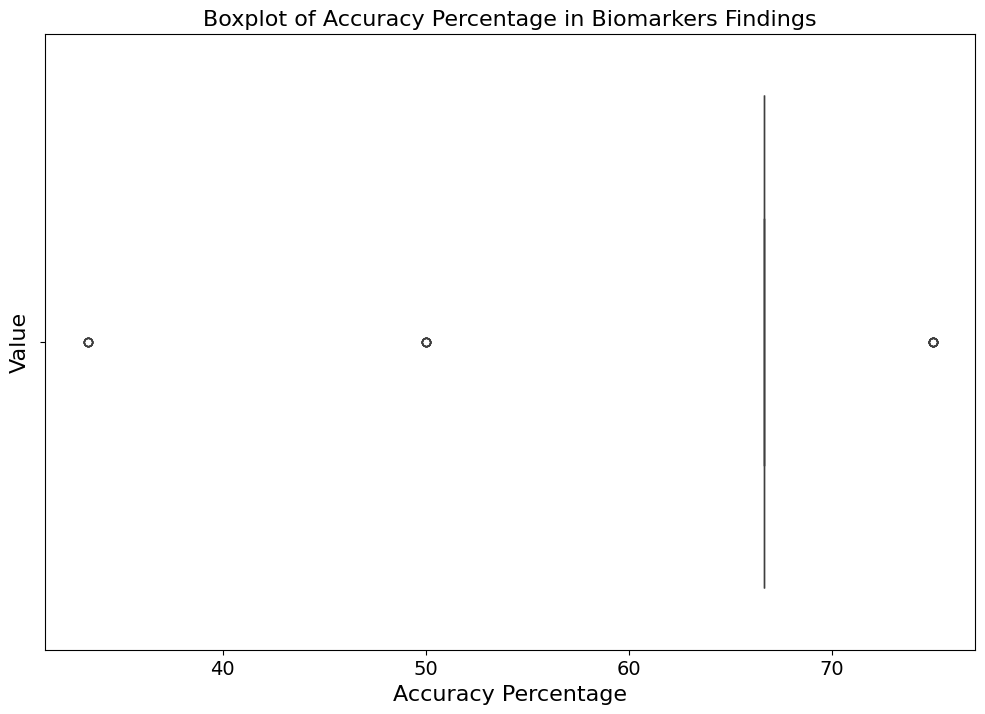

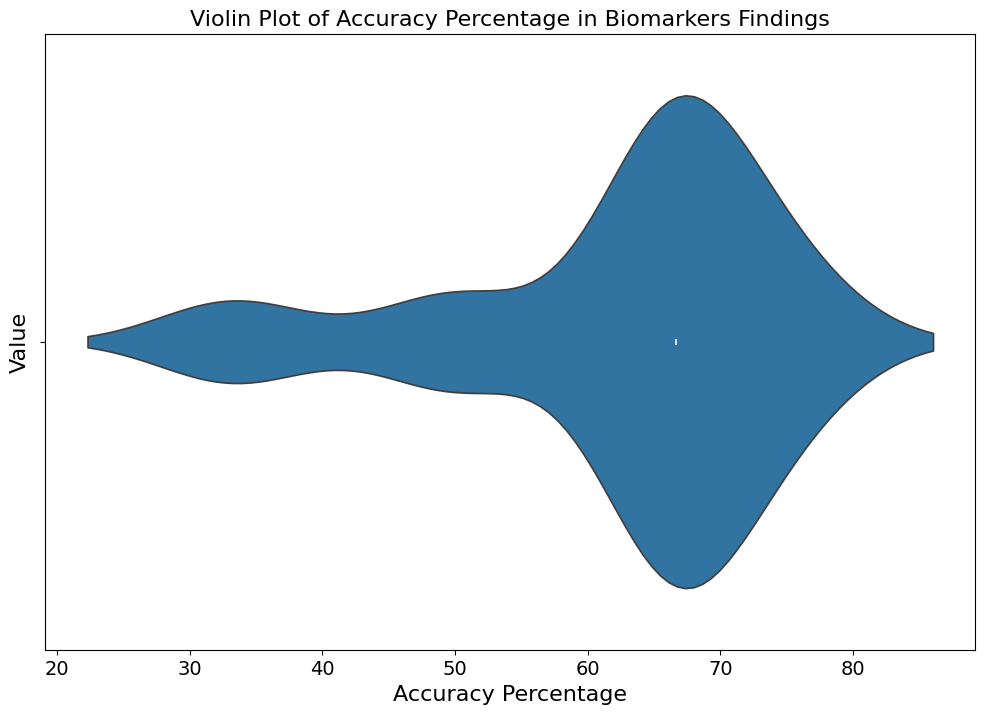

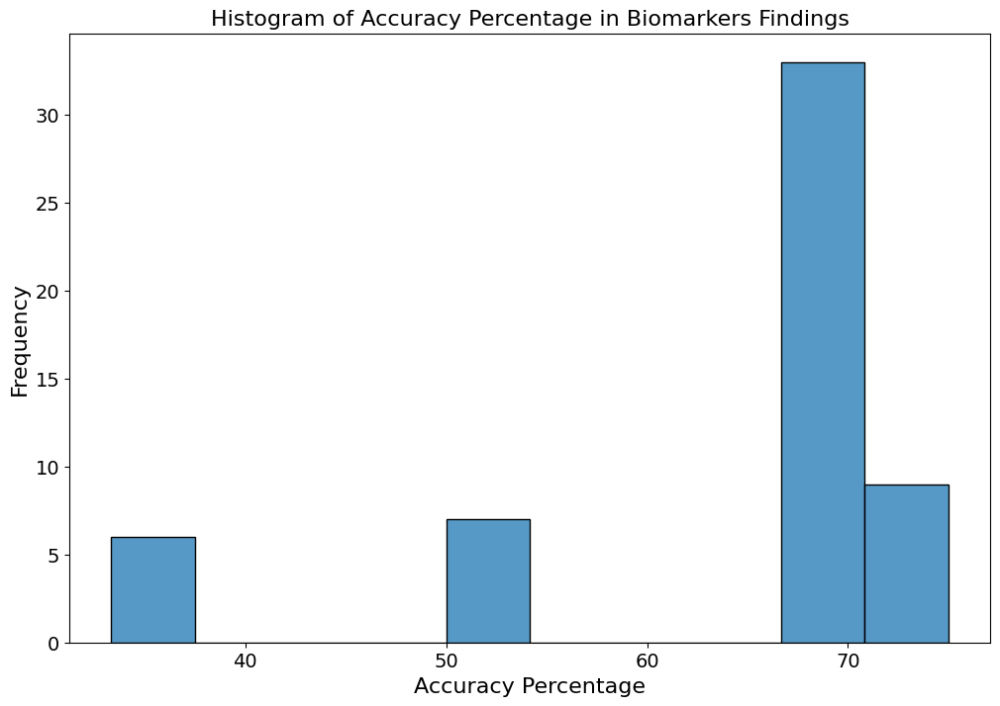

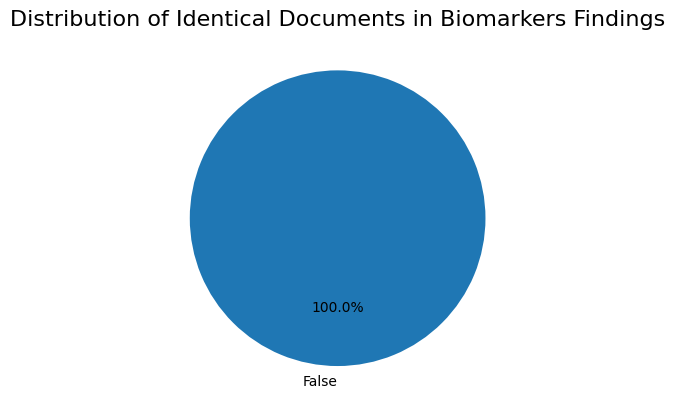

In [ ]:
plot_per_accuracy_percentage(df_biomarker, "Biomarkers" )

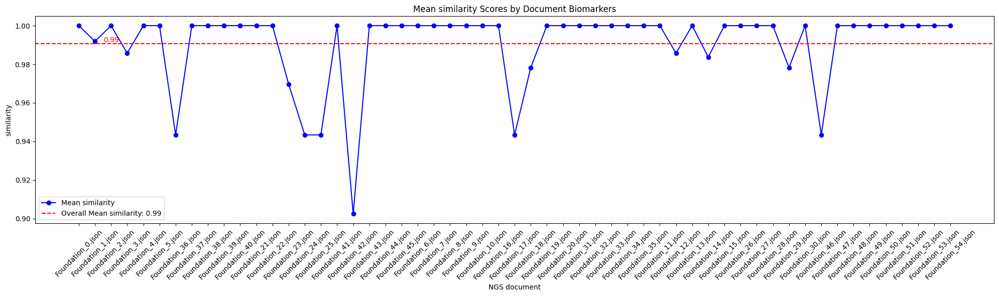

In [ ]:
plot_tendency_per_document_BYMETRIC(df_biomarker, "similarity", "Biomarkers")

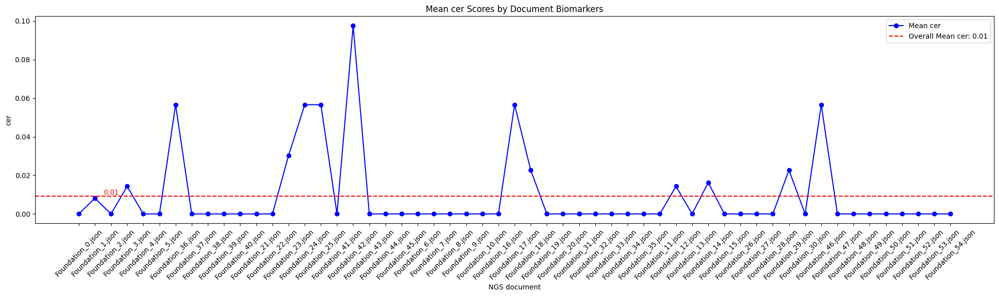

In [ ]:
plot_tendency_per_document_BYMETRIC(df_biomarker, "cer", "Biomarkers")

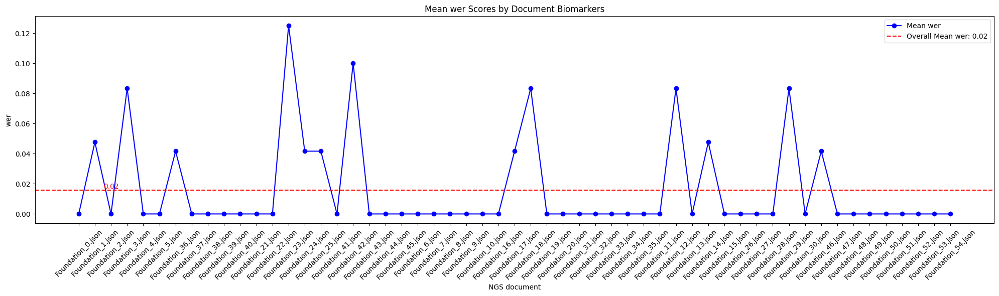

In [ ]:
plot_tendency_per_document_BYMETRIC(df_biomarker, "wer","Biomarkers")

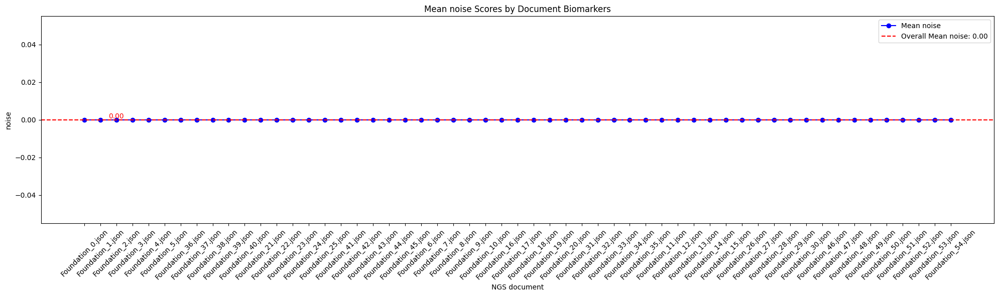

In [ ]:
plot_tendency_per_document_BYMETRIC(df_biomarker, "noise", "Biomarkers")

## Biomarker per Document

### Similarity

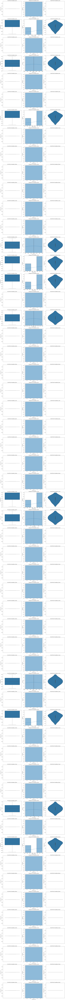

In [ ]:

plot_df_per_document(df_biomarker, "similarity")

### CER

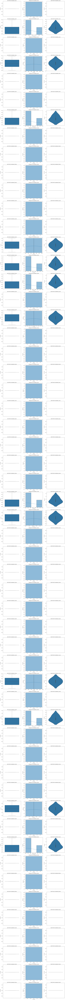

In [ ]:
plot_df_per_document(df_biomarker, "cer")

### WER

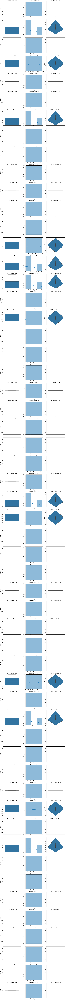

In [ ]:
plot_df_per_document(df_biomarker, "wer")

## Genomic

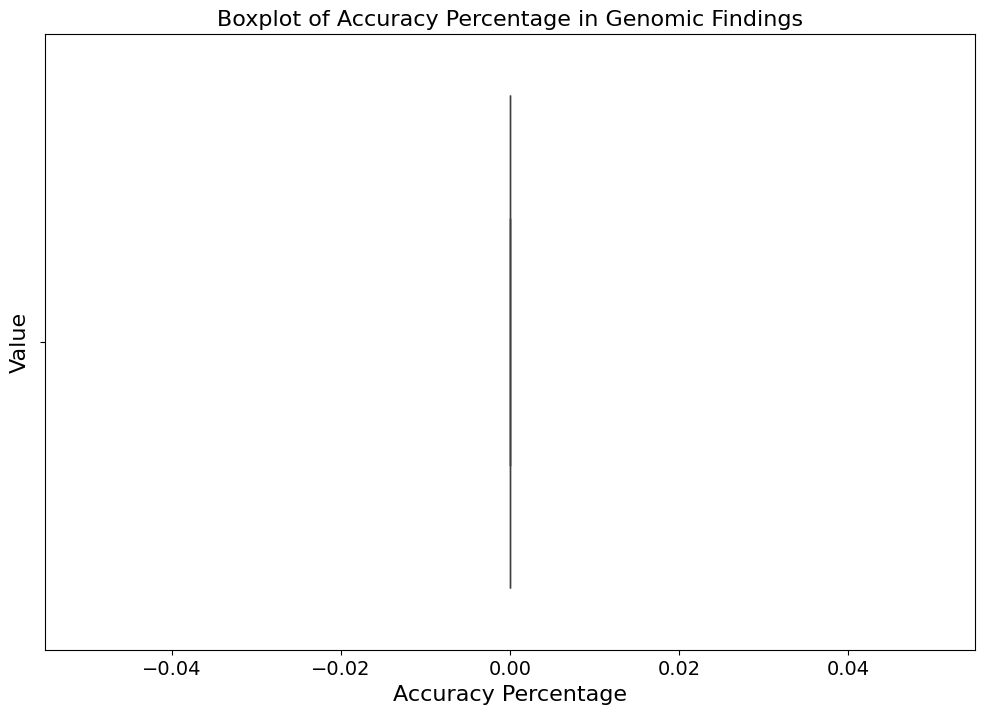

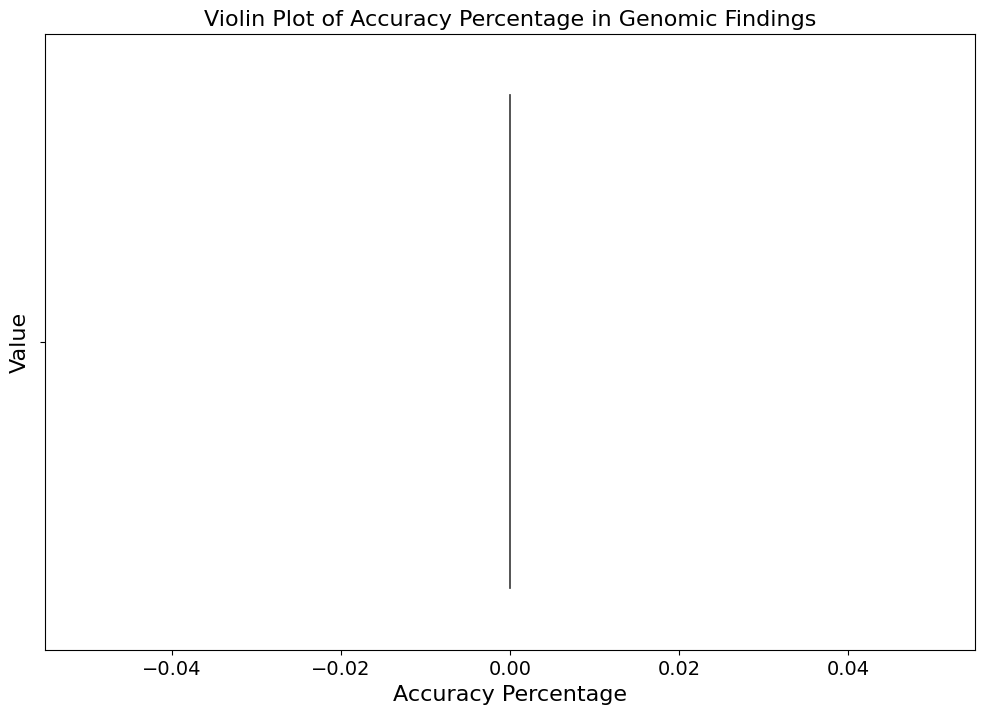

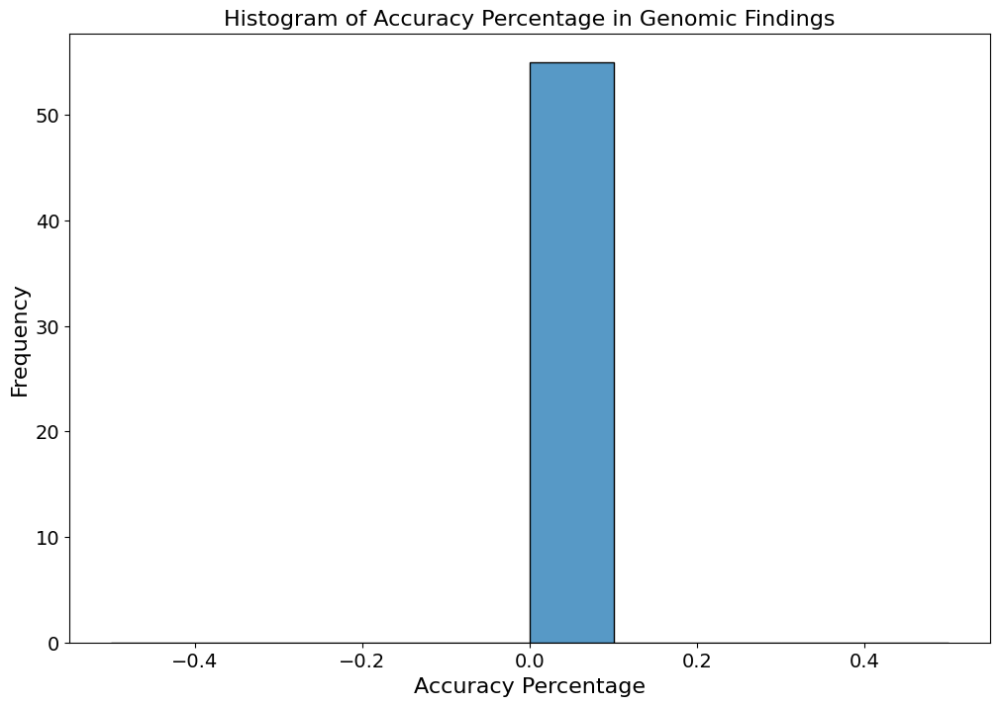

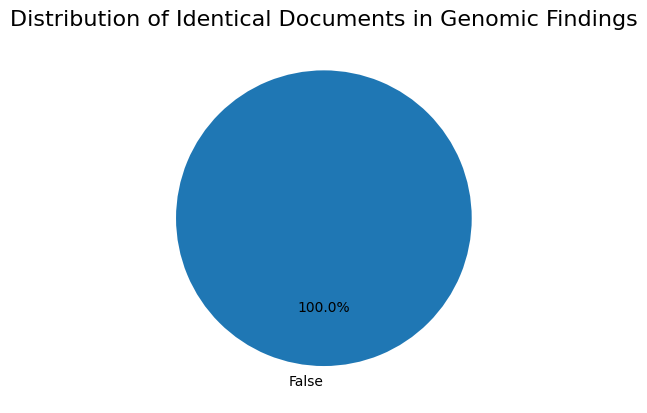

In [ ]:
plot_per_accuracy_percentage(df_genomic, "Genomic")

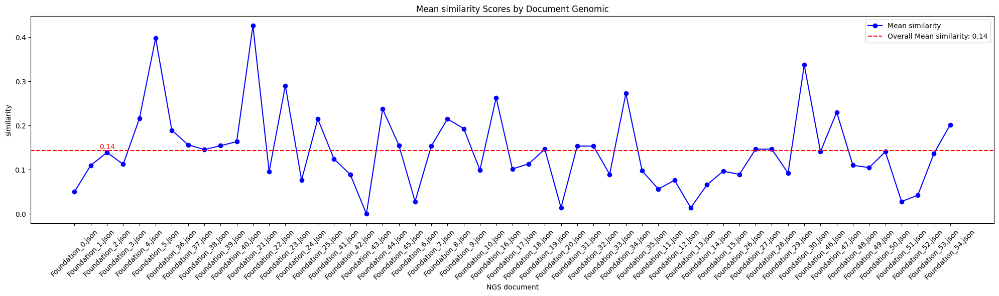

In [ ]:
plot_tendency_per_document_BYMETRIC(df_genomic, "similarity", "Genomic")

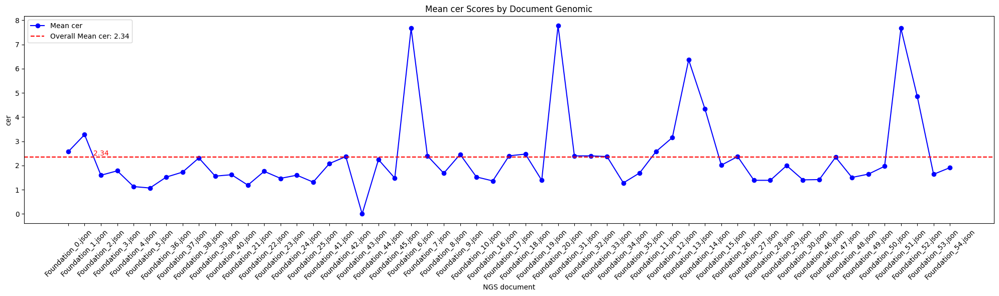

In [ ]:
plot_tendency_per_document_BYMETRIC(df_genomic, "cer","Genomic")

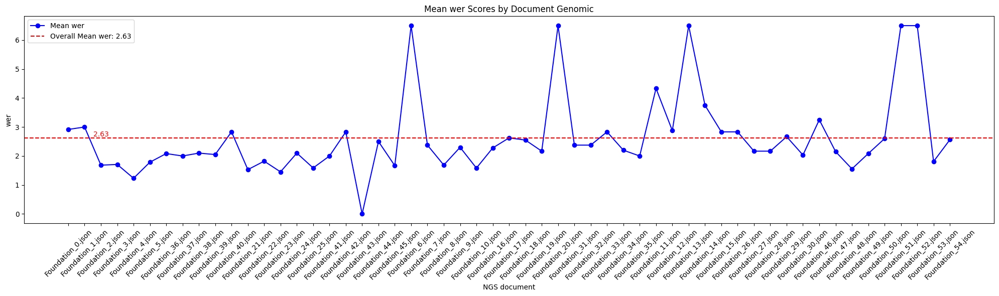

In [ ]:
plot_tendency_per_document_BYMETRIC(df_genomic, "wer","Genomic")

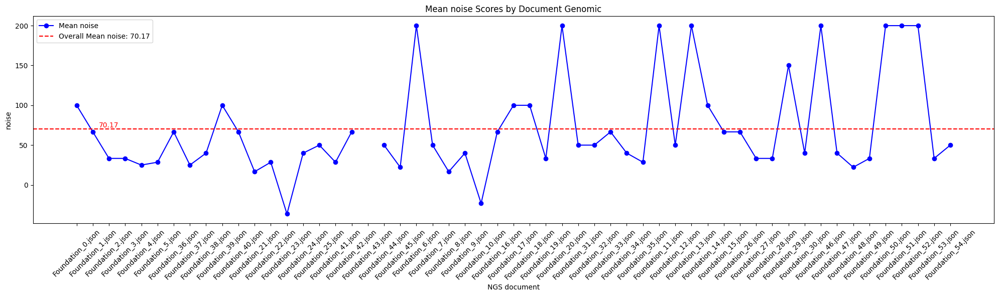

In [ ]:
plot_tendency_per_document_BYMETRIC(df_genomic, "noise","Genomic")

## Genomic per Document

### Similarity

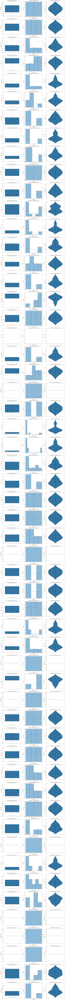

In [ ]:
plot_df_per_document(df_genomic, "similarity")

### CER

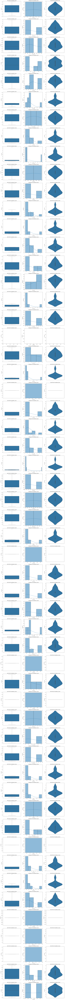

In [ ]:
plot_df_per_document(df_genomic, "cer")

### WER

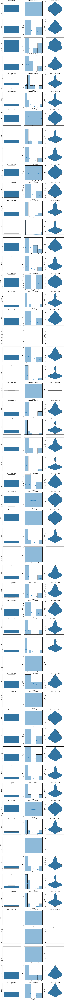

In [ ]:
plot_df_per_document(df_genomic, "wer")